In [2]:
from api import CtrLoRA

In [3]:
from PIL import Image
import glob,os

In [3]:
import glob,os
import json
with open('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/data_missing_5000.json','r') as f:
    data_5000 = json.load(f)

In [4]:
ctrlora = CtrLoRA(num_loras=1)
ctrlora.create_model(
    sd_file='/data07/shared/xxu/cvpr/may07/sd15/v1-5-pruned.ckpt',
    basecn_file='/data07/shared/xxu/cvpr/may07/ctrlora/ctrlora-basecn/ctrlora_sd15_basecn700k.ckpt',
    lora_files='/data07/shared/xxu/cvpr/may07/ctrfinetune/lightning_logs/version_2/save_path/epoch=3-step=199999_saved_lora.ckpt',
)

No module 'xformers'. Proceeding without it.
ControlInferenceLDM: Running in eps-prediction mode
DiffusionWrapper has 859.52 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Loaded model config from [configs/inference/ctrlora_sd15_rank128_1lora.yaml]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/sd15/v1-5-pruned.ckpt]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/ctrlora/ctrlora-basecn/ctrlora_sd15_basecn700k.ckpt]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/ctrfinetune/lightning_logs/version_2/save_path/epoch=3-step=199999_saved_lora.ckpt]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:15<00:00,  1.31it/s]


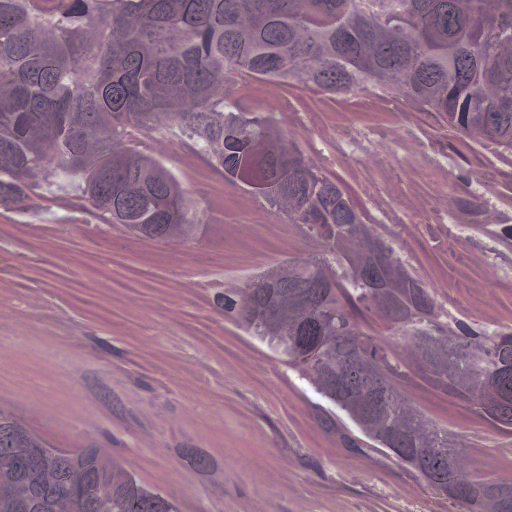

In [5]:
i = 5
samples = ctrlora.sample(
    cond_image_paths=os.path.join('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/original_images_test_5000_inst_map_pannuke_512',data_5000[i]['path']),
    prompt=data_5000[i]['caption'],
    n_prompt='worst quality',
    num_samples=1,
)
samples[0]

In [6]:
data_5000[i]['path']

'TCGA-BH-A1EW-01Z-00-DX1.A6A5F9C5-FB97-4DA3-A1EA-1F84BC006681_9696_10752.png'

In [7]:
import shutil,os
from tqdm import tqdm
for i in tqdm(range(20)):
    cond_image_paths=os.path.join('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/original_images_test_5000_inst_map_pannuke_512',data_5000[i]['path'])
    shutil.copy(cond_image_paths,'/home/xxu/cvpr/wacv/ctrlora/gradiosample/')
    prompt=data_5000[i]['caption']
    temp_prompt_path = os.path.join('/home/xxu/cvpr/wacv/ctrlora/gradiosample/',data_5000[i]['path'].replace('.png','.txt'))    
    with open(temp_prompt_path, 'w') as f:
        f.write(prompt)

100%|██████████| 20/20 [00:00<00:00, 45.24it/s]


In [6]:
for i in range(20):
    samples = ctrlora.sample(
        cond_image_paths=os.path.join('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/original_images_test_5000_inst_map_pannuke_512',data_5000[i]['path']),
        prompt=data_5000[i]['caption'],
        n_prompt='worst quality',
        num_samples=1,
    )
    save_path = os.path.join('/data07/shared/xxu/cvpr/may07/experiments/generated_images_epoch_3',data_5000[i]['path'])
    samples[0].save(save_path)

Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:25<00:00,  1.26s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:25<00:00,  1.30s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.37s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.38s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:26<00:00,  1.33s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:26<00:00,  1.31s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


In [7]:
ctrlora = CtrLoRA(num_loras=1)
ctrlora.create_model(
    sd_file='/data07/shared/xxu/cvpr/may07/sd15/v1-5-pruned.ckpt',
    basecn_file='/data07/shared/xxu/cvpr/may07/ctrlora/ctrlora-basecn/ctrlora_sd15_basecn700k.ckpt',
    lora_files='/data07/shared/xxu/cvpr/may07/ctrfinetune/lightning_logs/version_2/save_path/epoch=2-step=149999_saved_lora.ckpt',
)

ControlInferenceLDM: Running in eps-prediction mode
DiffusionWrapper has 859.52 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Loaded model config from [configs/inference/ctrlora_sd15_rank128_1lora.yaml]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/sd15/v1-5-pruned.ckpt]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/ctrlora/ctrlora-basecn/ctrlora_sd15_basecn700k.ckpt]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/ctrfinetune/lightning_logs/version_2/save_path/epoch=2-step=149999_saved_lora.ckpt]


In [8]:
for i in range(20):
    samples = ctrlora.sample(
        cond_image_paths=os.path.join('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/original_images_test_5000_inst_map_pannuke_512',data_5000[i]['path']),
        prompt=data_5000[i]['caption'],
        n_prompt='worst quality',
        num_samples=1,
    )
    save_path = os.path.join('/data07/shared/xxu/cvpr/may07/experiments/generated_images_epoch_2_149999',data_5000[i]['path'])
    samples[0].save(save_path)

Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.40s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.40s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.40s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.40s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:25<00:00,  1.28s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:23<00:00,  1.18s/it]


In [9]:
ctrlora = CtrLoRA(num_loras=1)
ctrlora.create_model(
    sd_file='/data07/shared/xxu/cvpr/may07/sd15/v1-5-pruned.ckpt',
    basecn_file='/data07/shared/xxu/cvpr/may07/ctrlora/ctrlora-basecn/ctrlora_sd15_basecn700k.ckpt',
    lora_files='/data07/shared/xxu/cvpr/may07/ctrfinetune/lightning_logs/version_2/save_path/epoch=2-step=119999_saved_lora.ckpt',
)

ControlInferenceLDM: Running in eps-prediction mode
DiffusionWrapper has 859.52 M params.
making attention of type 'vanilla' with 512 in_channels
Working with z of shape (1, 4, 32, 32) = 4096 dimensions.
making attention of type 'vanilla' with 512 in_channels
Loaded model config from [configs/inference/ctrlora_sd15_rank128_1lora.yaml]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/sd15/v1-5-pruned.ckpt]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/ctrlora/ctrlora-basecn/ctrlora_sd15_basecn700k.ckpt]
Loaded state_dict from [/data07/shared/xxu/cvpr/may07/ctrfinetune/lightning_logs/version_2/save_path/epoch=2-step=119999_saved_lora.ckpt]


In [10]:
for i in range(20):
    samples = ctrlora.sample(
        cond_image_paths=os.path.join('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/original_images_test_5000_inst_map_pannuke_512',data_5000[i]['path']),
        prompt=data_5000[i]['caption'],
        n_prompt='worst quality',
        num_samples=1,
    )
    save_path = os.path.join('/data07/shared/xxu/cvpr/may07/experiments/generated_images_epoch_2_119999',data_5000[i]['path'])
    samples[0].save(save_path)

Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:20<00:00,  1.02s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.44s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.37s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.37s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.37s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:24<00:00,  1.23s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.40s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.39s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.41s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.44s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.42s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:27<00:00,  1.40s/it]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:28<00:00,  1.40s/it]


In [6]:
import glob,os
cond_list = glob.glob('/data07/shared/xxu/cvpr/may07/pathgen/pathgen_2k_hovernet_pannuke_512/*.png')
cond_list.sort()
print(len(cond_list))

4850


In [9]:
i = 0
save_path = os.path.join('/data07/shared/xxu/cvpr/may07/pathgen/experiments/pathgen_2k_cond_512_generated',cond_list[i].split('/')[-1])
save_path

'/data07/shared/xxu/cvpr/may07/pathgen/experiments/pathgen_2k_cond_512_generated/TCGA-05-4244-01Z-00-DX1.d4ff32cd-38cf-40ea-8213-45c2b100ac01_29824_14272.png'

In [10]:
for i in range(100):
    samples = ctrlora.sample(
        cond_image_paths=cond_list[i],
        prompt=data_5000[i]['caption'],
        n_prompt='worst quality',
        num_samples=1,
    )
    save_path = os.path.join('/data07/shared/xxu/cvpr/may07/pathgen/experiments/pathgen_2k_cond_512_generated',cond_list[i].split('/')[-1])
    samples[0].save(save_path)

Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.58it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.58it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.57it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|██████████| 20/20 [00:12<00:00,  1.58it/s]


Data shape for DDIM sampling is (1, 4, 64, 64), eta 0
Running DDIM Sampling with 20 timesteps


DDIM Sampler:  65%|██████▌   | 13/20 [00:08<00:04,  1.55it/s]


KeyboardInterrupt: 

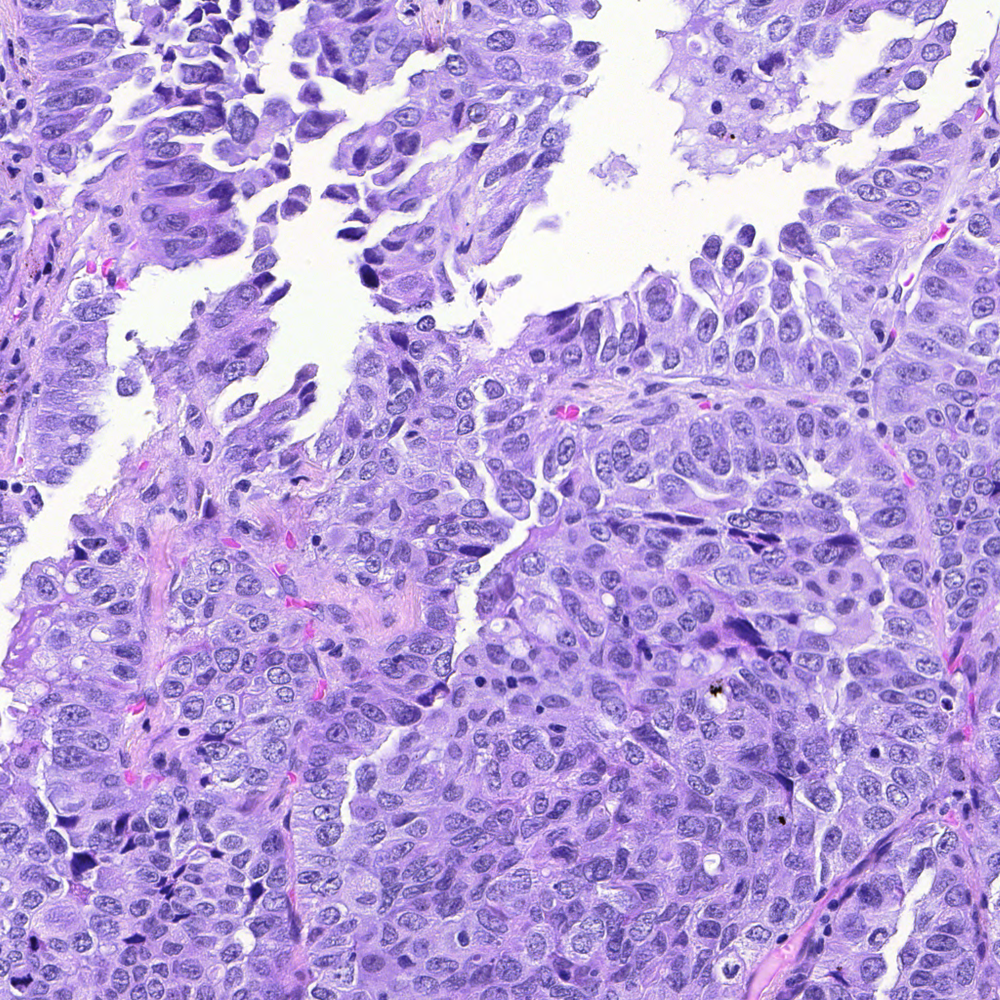

In [11]:
Image.open('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/other_data/pathgen_4k/images_2k/'+'TCGA-05-4244-01Z-00-DX1.d4ff32cd-38cf-40ea-8213-45c2b100ac01_29824_14272.png')

In [12]:
random_name = ['TCGA-05-4244-01Z-00-DX1.d4ff32cd-38cf-40ea-8213-45c2b100ac01_29824_14272.png','TCGA-05-4244-01Z-00-DX1.d4ff32cd-38cf-40ea-8213-45c2b100ac01_30496_13600_0.png']

In [ ]:
import os
import random
from PIL import Image
import matplotlib.pyplot as plt

# 路径设定
image_root = "/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/other_data/pathgen_4k/images_2k/"
overlay_root = "/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/other_data/pathgen_4k_segmentation/pathgen_2k_images_hovernet_pannuke/overlay"
cond_root = "/data07/shared/xxu/cvpr/may07/pathgen/pathgen_2k_hovernet_pannuke"

# 读取所有 PNG 文件名
png_files = [f for f in os.listdir(image_root) if f.endswith('.png')]
if not png_files:
    raise FileNotFoundError("No PNG files found in the specified directory.")

# 随机选择一个
random_name = random.choice(png_files)
print("Selected image:", random_name)

# 构造完整路径
image_path = os.path.join(image_root, random_name)
overlay_path = os.path.join(overlay_root, random_name)
cond_path = os.path.join(cond_root, random_name)

# 加载图像
img = Image.open(image_path)
overlay = Image.open(overlay_path)
cond = Image.open(cond_path)

# 可视化
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.title("Image 2K")
plt.imshow(img)
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title("Overlay")
plt.imshow(overlay)
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Condition")
plt.imshow(cond)
plt.axis('off')

plt.tight_layout()
plt.show()

In [13]:
random_name = 'TCGA-05-4245-01Z-00-DX1.36ff5403-d4bb-4415-b2c5-7c750d655cde_10336_67104.png'
img_2k = Image.open(os.path.join('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/other_data/pathgen_4k/images_2k/',random_name))
img_2k_cond = Image.open(os.path.join('/data07/shared/xxu/cvpr/may07/pathgen/pathgen_2k_hovernet_pannuke/',random_name))

img_2k_cond_512 = Image.open(os.path.join('/data07/shared/xxu/cvpr/may07/pathgen/pathgen_2k_hovernet_pannuke_512/',random_name))
ctrlora_img = Image.open(os.path.join('/data07/shared/xxu/cvpr/may07/pathgen/experiments/pathgen_2k_cond_512_generated',random_name))
sr_img = Image.open(os.path.join('/data07/shared/xxu/cvpr/may07/pathgen/experiments/pathgen_2k_cond_512_generated_upscale',random_name.replace('.png','_0.png')))

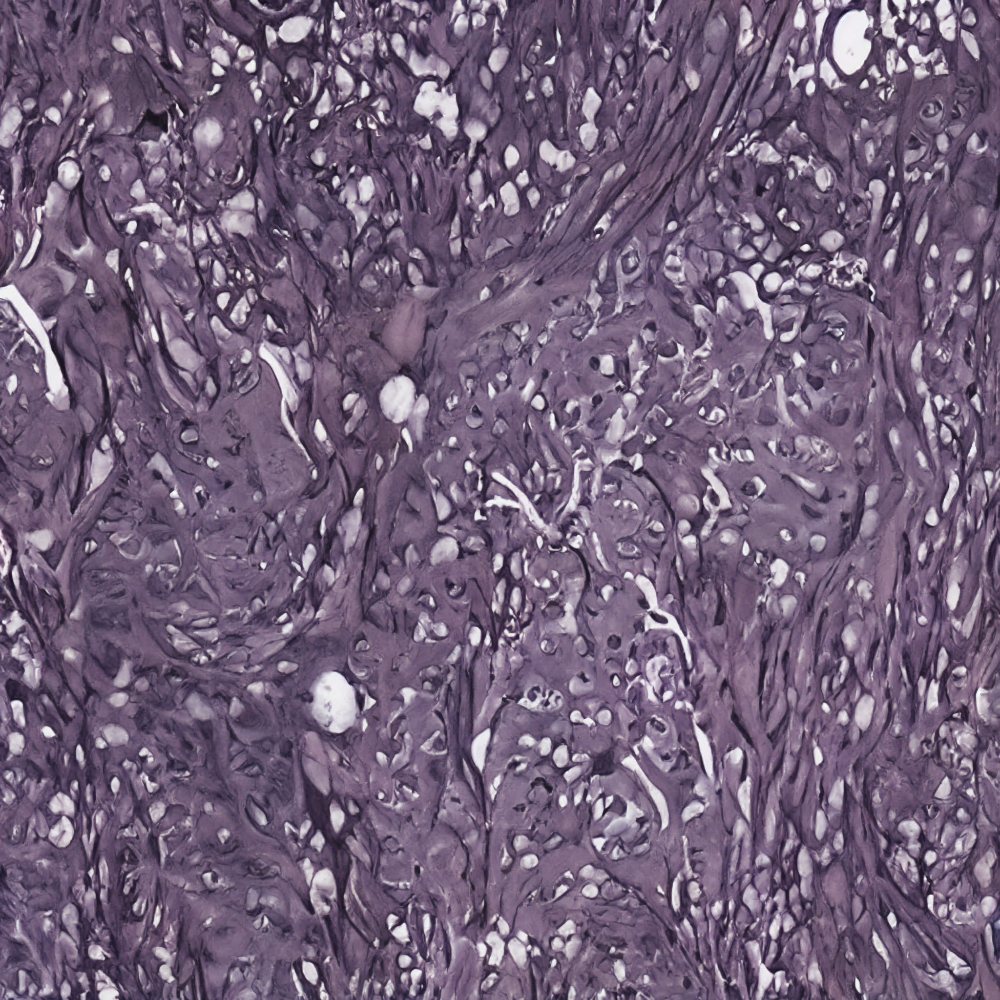

In [24]:
sr_img

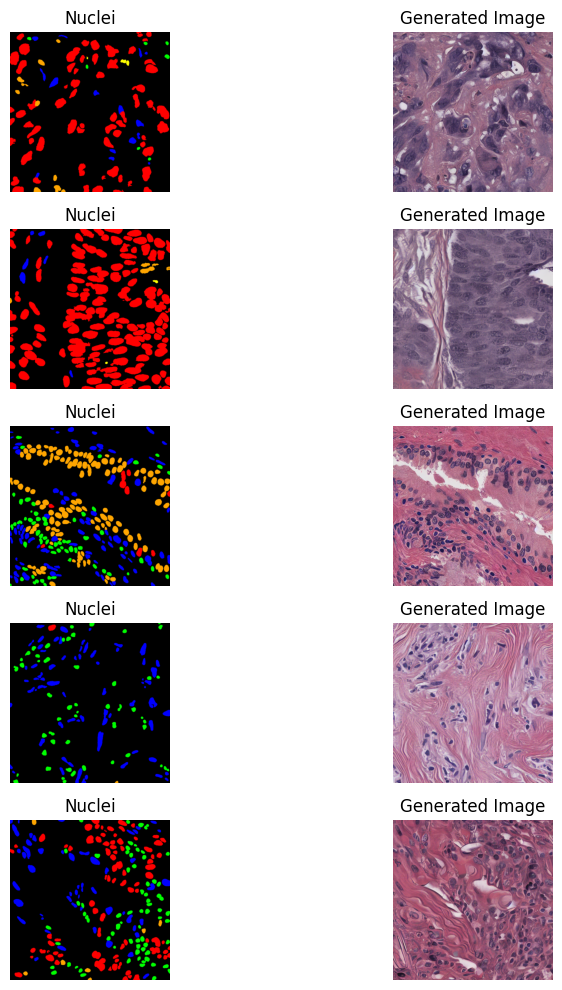

In [7]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

# Define paths
cond_image_dir = "/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/original_images_test_5000_inst_map_pannuke_512"
gen_image_dir = "/data07/shared/xxu/cvpr/may07/experiments/generated_images_epoch_3"

# List image filenames
cond_image_names = [f for f in os.listdir(cond_image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Randomly select 5 filenames
selected_names = random.sample(cond_image_names, 5)

# Plot
plt.figure(figsize=(10, 10))
for i, name in enumerate(selected_names):
    # Load images
    cond_path = os.path.join(cond_image_dir, name)
    gen_path = os.path.join(gen_image_dir, name)

    cond_img = Image.open(cond_path)
    gen_img = Image.open(gen_path)

    # Plot conditional image
    plt.subplot(len(selected_names), 2, 2*i + 1)
    plt.imshow(cond_img)
    plt.title(f"Nuclei")
    plt.axis('off')

    # Plot generated image
    plt.subplot(len(selected_names), 2, 2*i + 2)
    plt.imshow(gen_img)
    plt.title(f"Generated Image")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [8]:
selected_names

['TCGA-C4-A0F0-01Z-00-DX1.8EBBC2EF-DA6F-4901-838D-C1AC80E83E92_27904_26528.png',
 'TCGA-A8-A06N-01Z-00-DX1.E25E65F8-DFE0-47CF-9FAB-B82EE8E321F7_12928_37312.png',
 'TCGA-V1-A8WN-01Z-00-DX1.BE5E60A2-FF72-421B-A356-7644493DC708_58176_6240.png',
 'TCGA-E9-A54Y-01Z-00-DX1.5FD70369-6514-4E5E-8BEF-65DAC5671E1A_50336_33024.png',
 'TCGA-CV-7100-01Z-00-DX1.44DFCAC1-2567-40E7-8F03-AF1FB742B012_21984_50656.png']

In [10]:
data_5000[0:1]

[{'wsi_id': 'TCGA-O2-A52N-01Z-00-DX1.FF1DD149-4DBE-44C7-872D-FA7E8FE770A8',
  'position': "['49600', '9536']",
  'caption': 'The lung tissue image shows fibrosis with pink-staining collagen, disrupted architecture, and loss of alveolar pattern. Increased cellularity suggests inflammatory infiltrates, with possible inflammatory cell or microorganism aggregates. These findings indicate a chronic pathological process affecting lung structure and function, consistent with a fibrotic lung disease or chronic infection.',
  'path': 'TCGA-O2-A52N-01Z-00-DX1.FF1DD149-4DBE-44C7-872D-FA7E8FE770A8_49600_9536.png'}]

In [11]:
matched_items = [item for item in data_5000 if any(name in item['path'] for name in selected_names)]

# Print matched results
for item in matched_items:
    print(f"Matched: {item['path']}")
    print(f"Caption: {item['caption']}")
    print()

Matched: TCGA-E9-A54Y-01Z-00-DX1.5FD70369-6514-4E5E-8BEF-65DAC5671E1A_50336_33024.png
Caption: The breast tissue shows elongated spindle cells in interlacing patterns with eosinophilic cytoplasm and uniform nuclei, surrounded by collagen and scattered lymphocytes. Suggestive of a benign fibroepithelial lesion like fibroadenoma or phyllodes tumor, these mesenchymal features indicate a fibroblastic or myofibroblastic origin, likely benign due to the absence of significant atypia or mitotic activity.

Matched: TCGA-C4-A0F0-01Z-00-DX1.8EBBC2EF-DA6F-4901-838D-C1AC80E83E92_27904_26528.png
Caption: The tissue features high pleomorphism, hyperchromatic variably sized nuclei with prominent nucleoli, and eosinophilic cytoplasm. Lack of normal urothelial layering and disorganized, scant stroma are evident. Irregular gland-like structures suggest neoplastic changes, likely urothelial carcinoma, pending further clinical and immunohistochemical correlation for a definitive diagnosis.

Matched: TCGA-

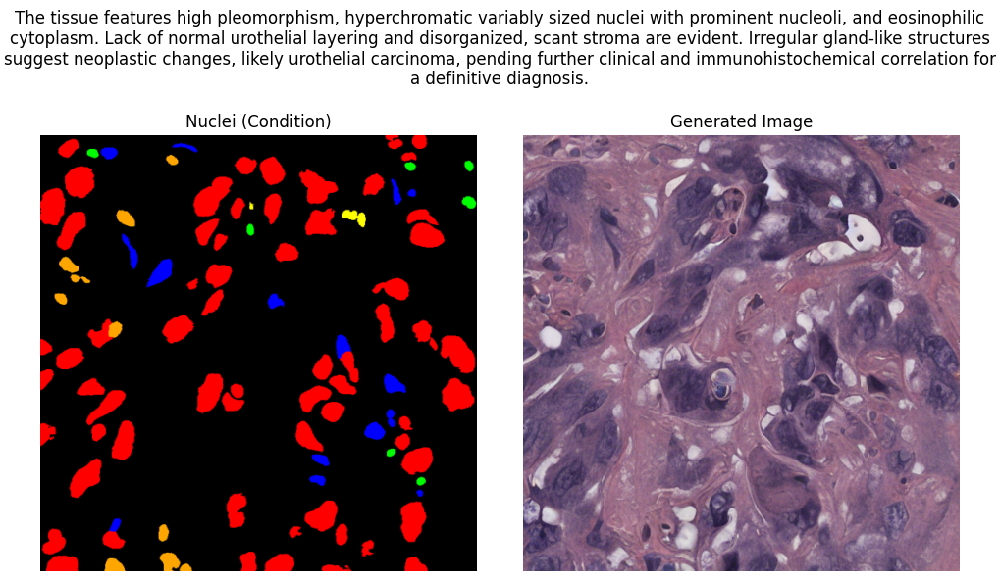

In [18]:
import matplotlib.pyplot as plt
from PIL import Image
import os

# 示例变量
i = 1
name = matched_items[i]['path']
caption = matched_items[i]['caption']
cond_image_path = os.path.join('/data06/shared/xxu/miccai2025/color_to_HR/tcga_text_to_image_larger/experiments/original_images_test_5000_inst_map_pannuke_512', name)
gen_image_path = os.path.join('/data07/shared/xxu/cvpr/may07/experiments/generated_images_epoch_3', name)

# 打开图片
cond_img = Image.open(cond_image_path)
gen_img = Image.open(gen_image_path)

# 绘图
plt.figure(figsize=(10, 6))

# 添加caption
plt.suptitle(caption, fontsize=12, wrap=True)

# Nuclei map (conditional image)
plt.subplot(1, 2, 1)
plt.imshow(cond_img)
plt.title("Nuclei (Condition)")
plt.axis('off')

# Generated image
plt.subplot(1, 2, 2)
plt.imshow(gen_img)
plt.title("Generated Image")
plt.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.95])  # 留出上方空间给 suptitle
plt.show()


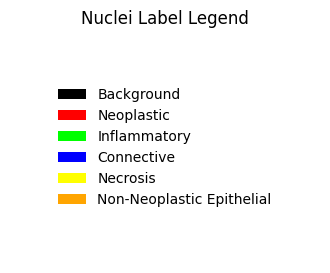

In [22]:
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# Neoplastic
# Inflammatory
# Connective
# Dead
# Non-Neoplastic Epithelial

# 定义颜色和标签
label_mapping = {
    "Background": [0  ,   0,   0],       # black
    "Neoplastic": [255,   0,   0],       # red
    "Inflammatory": [0  , 255,   0],       # green
    "Connective": [0  ,   0, 255],       # blue
    "Necrosis": [255, 255,   0],       # yellow
    "Non-Neoplastic Epithelial": [255, 165,   0]        # orange
}

# 构造 legend handles
legend_elements = [
    Patch(facecolor=[r/255 for r in rgb], label=label)
    for label, rgb in label_mapping.items()
]

# 绘制图例
plt.figure(figsize=(4, 3))
plt.legend(handles=legend_elements, loc='center', frameon=False)
plt.axis('off')
plt.title("Nuclei Label Legend")
plt.show()



In [1]:
import numpy as np
from PIL import Image

# 创建一个全黑的 512x512 图像（黑色即 RGB = (0, 0, 0)）
black_image = np.zeros((512, 512, 3), dtype=np.uint8)

# 转换为图像对象
img = Image.fromarray(black_image)

# 保存图像
img.save("black_512x512.png")


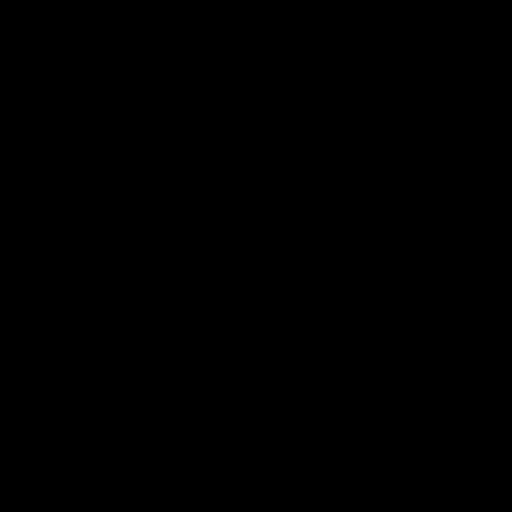

In [2]:
img